## Use getters and setters in OOP

## From PART 4 - OOP - UDEMY

18. Properties - Lecture  

# We create properties as class attributes but somehow they become BOUND to the instnace of the class 

## properties use the descriptor protocol

## Properties are NOT stored in instance dictionary!

### property is a CLASS

### x.getter(get_x) will return a PROPERTY that has the getter method set to get_x

In [ ]:
x = property()
x = x.getter(get_x)
x = x.setter(set_x)

## Or use the initializer

In [ ]:
x = property(fget=get_x,fset=set_x)

## Or Mixed

In [ ]:
x = property(get_x)
x = x.setter(set_x)

1. creates function language
2. call property passing it in language 
3. and w/e is returned is reassigned to the symbol language

### Hence now language is an attibute of our class that happens to be a property instance!

### language is a property instance

In [ ]:
def MyClass:
    
    @property
    def language(self):
        return self._language
    
    #equivalent to:
    def language(self):
        return self._language
    
    language = property(language)

In [ ]:
    def set_language(self, value):
        self._language = value

    language = language.setter(set_language)   #like x = x.setter( set_x )
    
    # equivalently:
    @language.setter
    def language(self, value):
        self._language = value

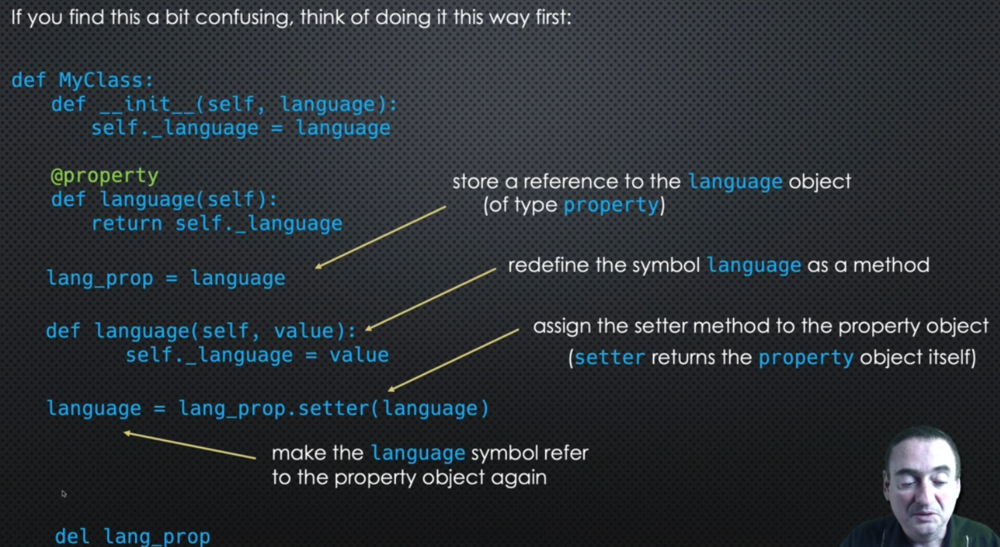

## READ ONLY PROPERTIES: without a setter

## Calculated property: calculating every time I request it!!!

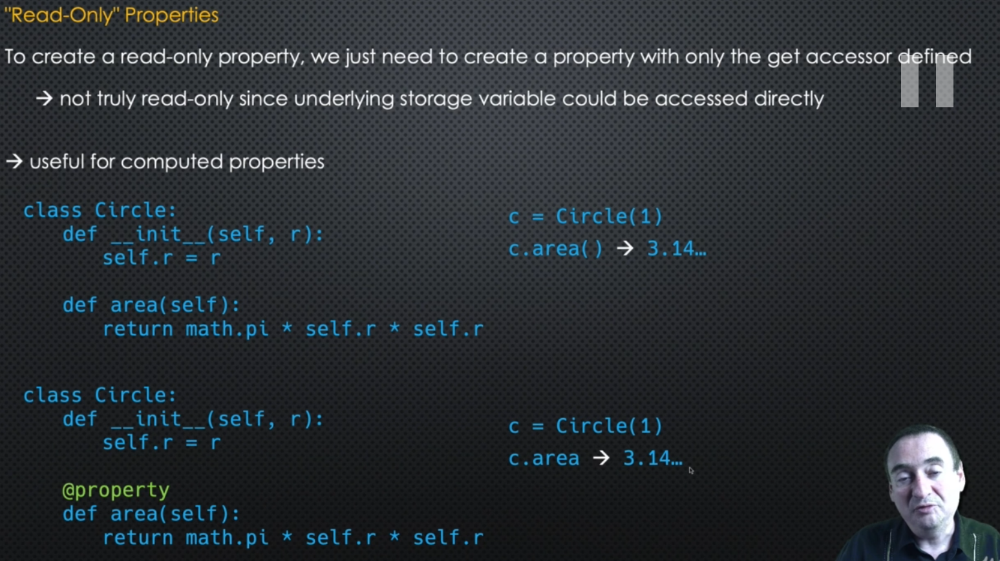

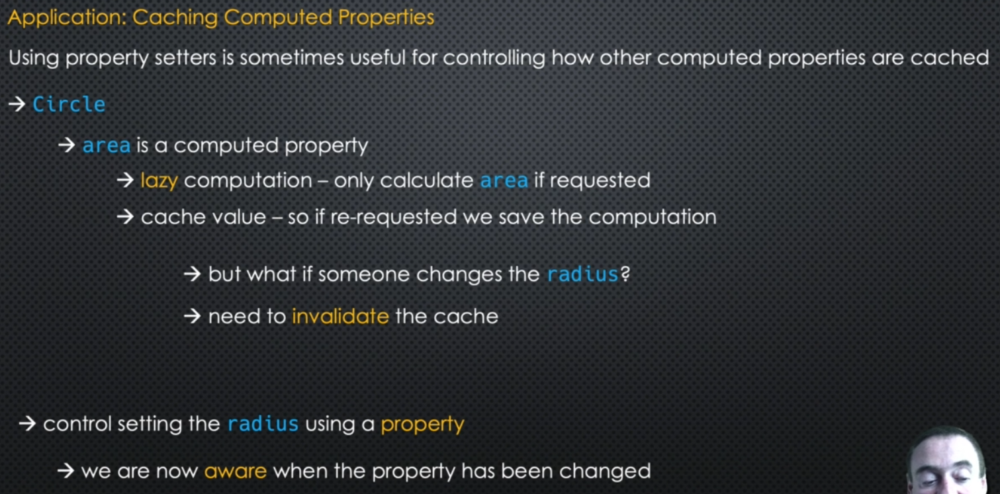

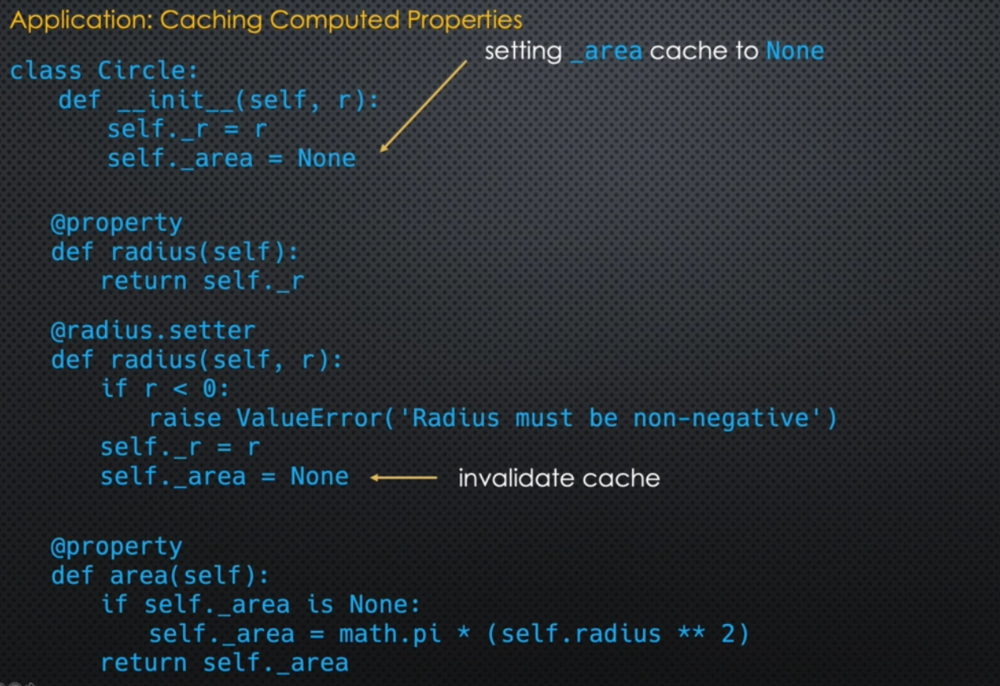

## CACHES IS A VERY GOOD USE CASE FOR CALCULATED PROPERTIES

## Is seems like we are using url as an attribute, but if url changes we want to recompute the _page ectc..  --> Make url into a property

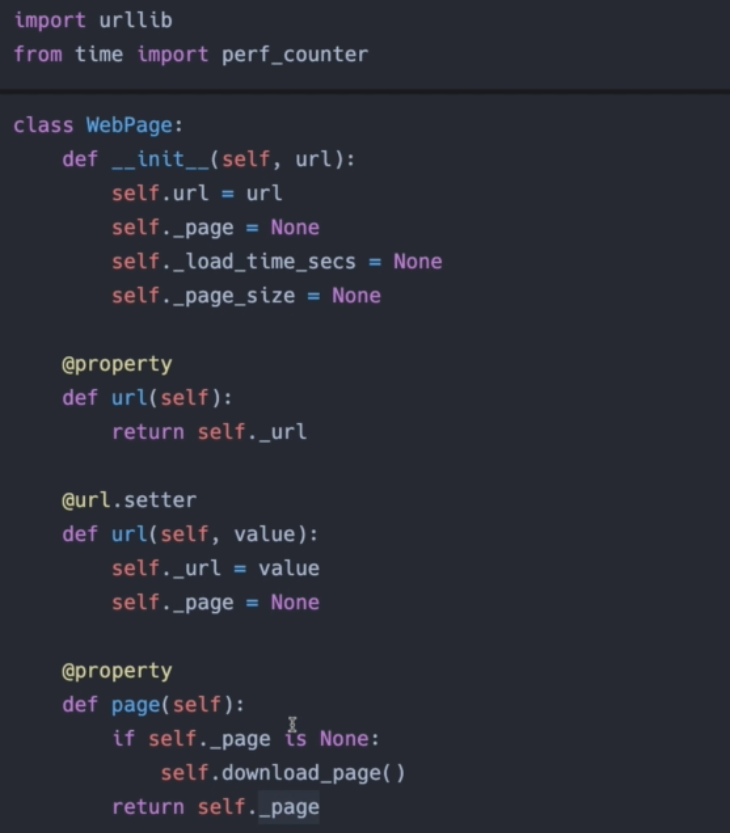

### direct access to attibutes

In [1]:
class MyClass:
    def __init__(self, language):
        self.language = language

In [2]:
obj= MyClass('Python')
obj.language

'Python'

In [3]:
obj.language = 'Java'
obj.language

'Java'

### Private attributes with underscore `_`

In [ ]:
class MyClass:
    def __init__(self, language):
        self._language = language
        
    # getter
    def get_language(self):
        return self._language
    
    #setter
    def set_language(self, value):
        self._language = value

## Problem is now that we cannot say
- obj.language $\;\;\; \rightarrow$  obj.get_language()
- obj.language = 'Java'  $\rightarrow$  obj.set_language('Java')

In [7]:
class MyClass:
    def __init__(self, language):
        self._language = language
        
    # getter
    def get_language(self):
        print('getting value')
        return self._language
    
    #setter
    def set_language(self, value):
        print('setting value')
        self._language = value
        
    # property object (property is a class and we created an instance of that class) 
    # This is a class attribute but why can we call it on each instance separately?
    language = property(fget=get_language, fset=set_language)

In [8]:
obj= MyClass('Python')
obj.language

getting value


'Python'

In [9]:
obj.language = 'Java'
obj.language

setting value
getting value


'Java'

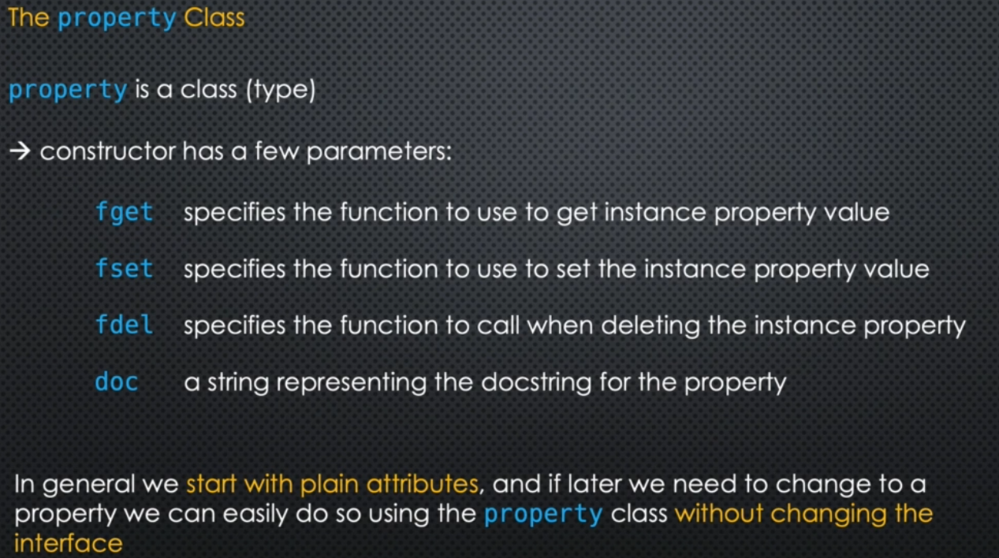

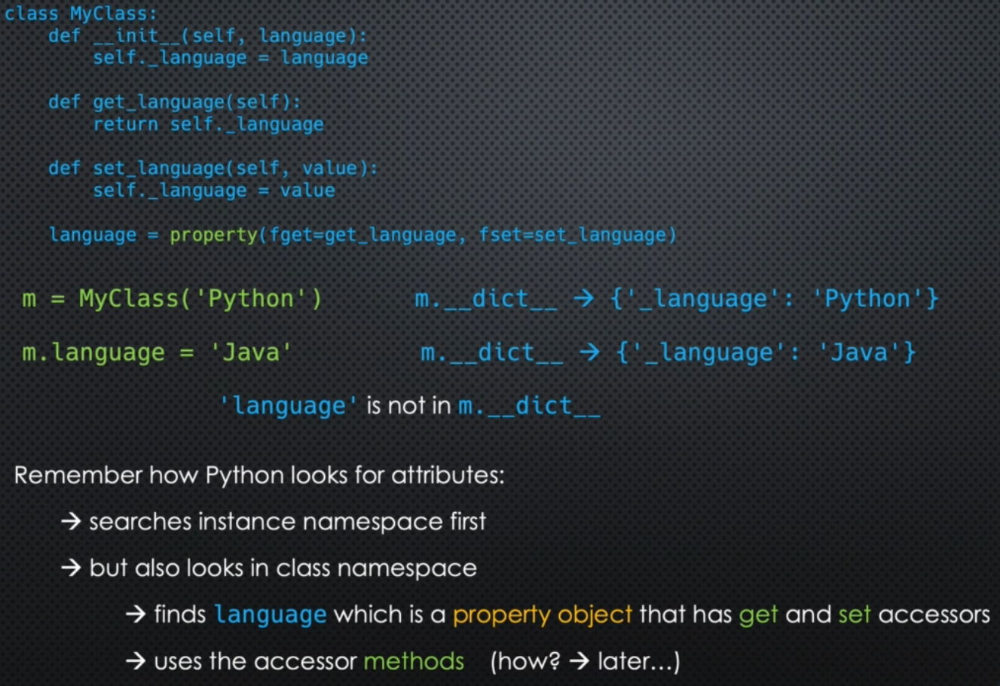

In [ ]:
self is gonna be m and language is gonna be 'Python'
m.__dict__ = {'_language': 'Python'}

don't use self._name = name in init because you could create invalid name.
Use the setter instead

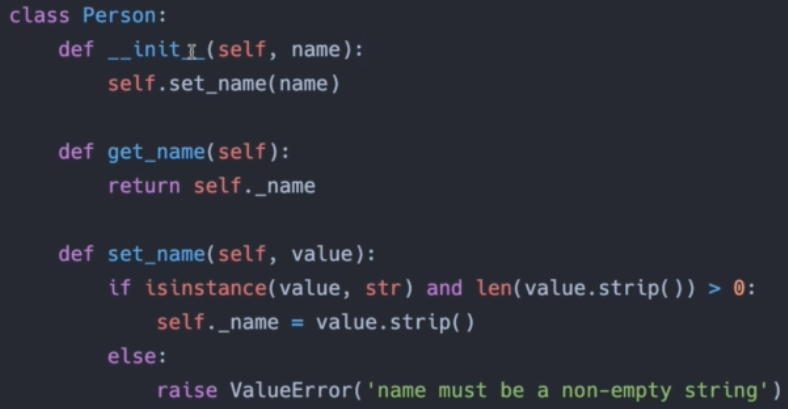

you can still set p._name = 231, bypasssing setter but you shouldnt access private variables _name

In [10]:
a= property()
type(a)

property

In [11]:
a

The get_name in fget and set_name in fset will be called as bound methods!

with p.name it realizes name is a property object, hence it is going to call get_name bound to the object p

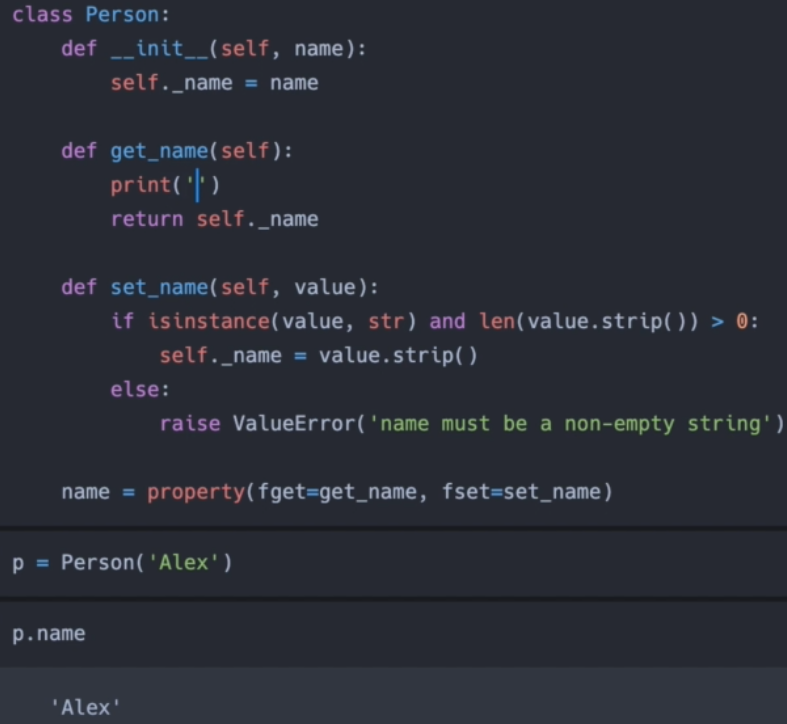

You can use the setattr and getattr

Notice that 'name' belongs to the class (it is a class attribute!) not the instance. But when you call the property object from the instance it gets bound to the instance and get_name, set_name get called as bound method

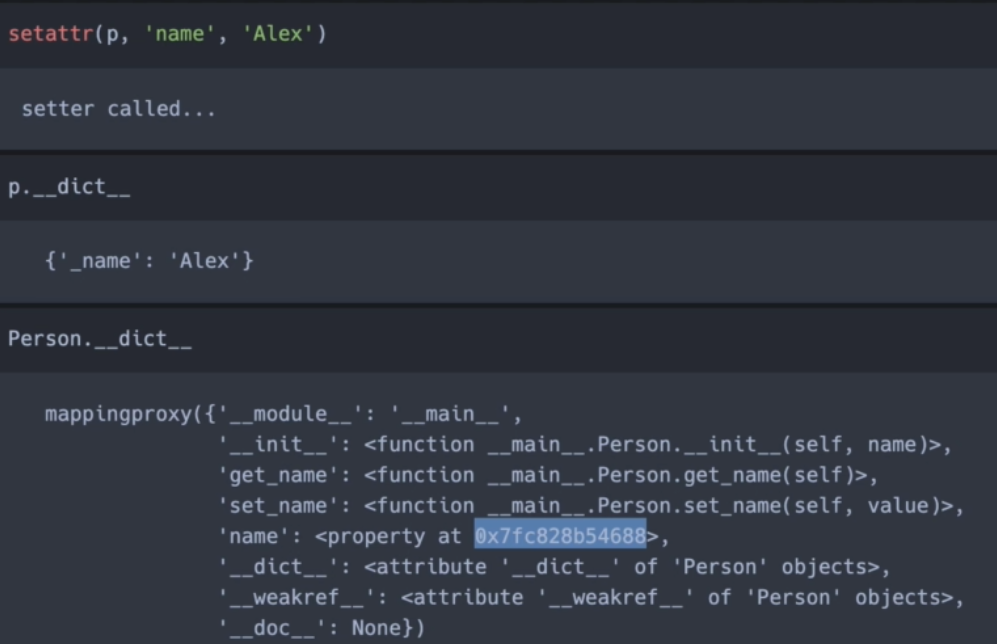

Instance attributes masking class attribute

Even if you have an instance with attribute 'name' hardcoded, python will use the property to get the name

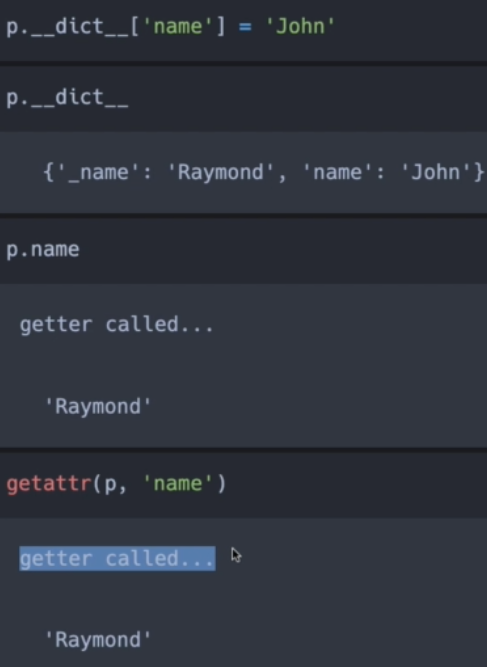

deleter does not delete the property but the attribute from the instance

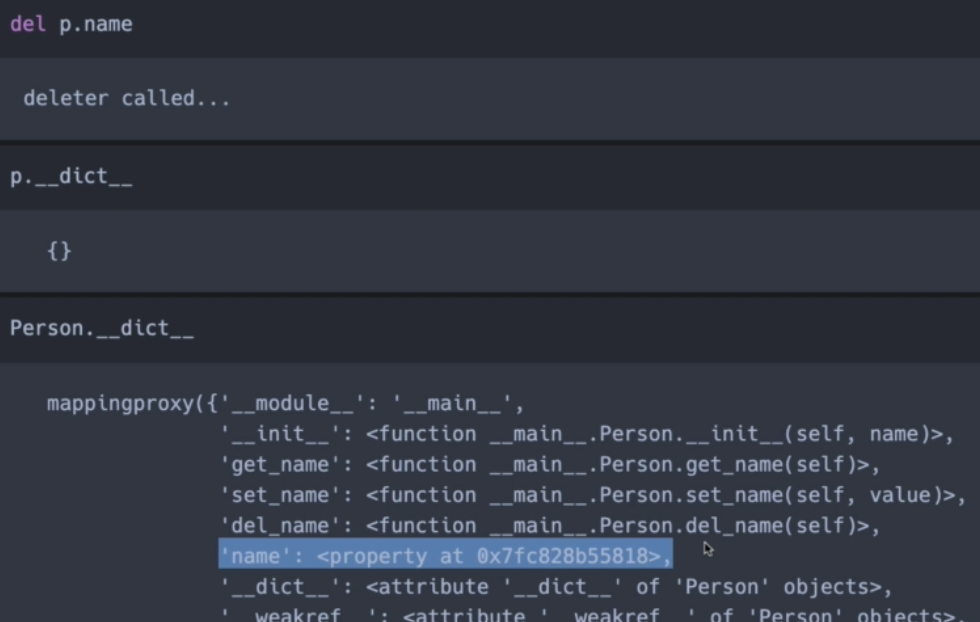

### Property decorators

x.getter will return a property that will have the getter set to get_x

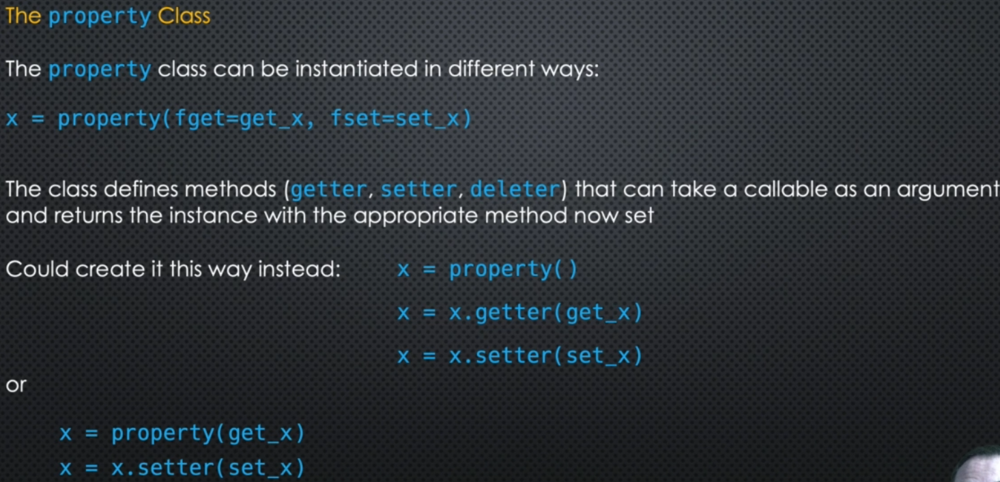

**we pass the language method as a setter inside the property()**

creating a property with setter the language method (def) and then reassinging it to the symbol language

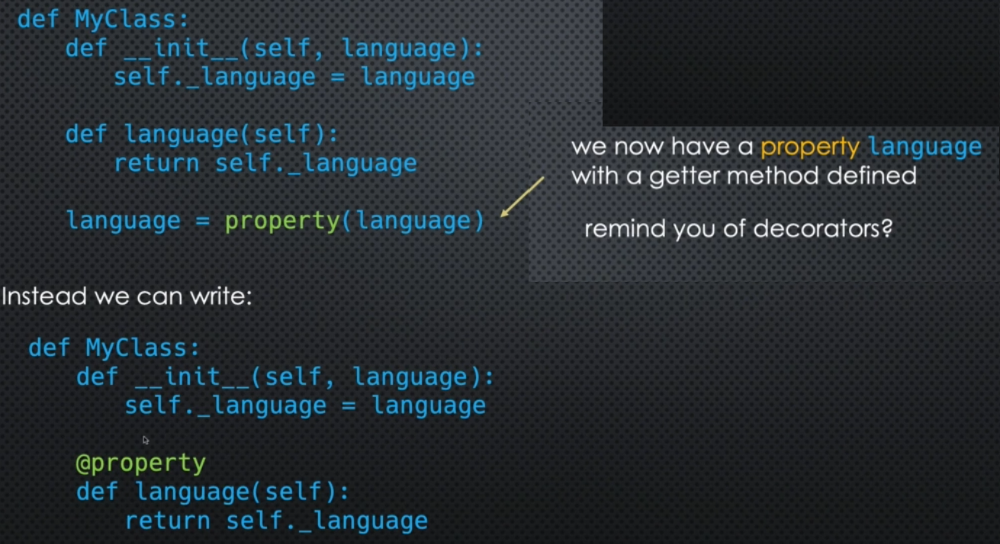

Now language is an attribute of our class that happens to be a property instance

Now to set a setter on the language property, we call the .setter method on that propery object language i.e. language.setter(set_language) like we did x = x.getter(get_x) previously 

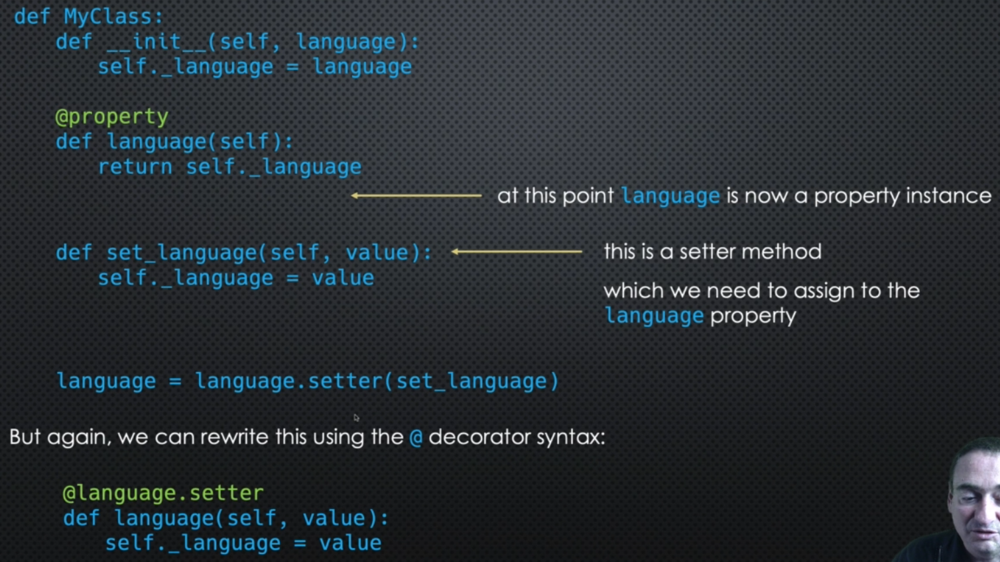

Remember that language.setter returns a property instance language with the setter method set_language

# My attempt to understand it:

## Define only getter and then add setter outside of the class

In [13]:
class MyClass:
    
    def __init__(self, language):
        self._language = language
        
    def language(self):
        return self._language
    
    language = property(language)

In [14]:
p = MyClass('Greek')
p.language

'Greek'

In [15]:
MyClass.language

In [16]:
def set_language(self, value):
    self._language = value

In [17]:
MyClass.language = MyClass.language.setter(set_language)

In [18]:
p.language = 'English'
p.language

'English'

### Now call the setter as language

In [19]:
class MyClass:
    
    def __init__(self, language):
        self._language = language
        
    def language(self):
        return self._language
    
    language = property(language)

In [20]:
p = MyClass('Greek')
p.language

'Greek'

In [21]:
MyClass.language

In [22]:
def language(self, value):
    self._language = value

In [23]:
MyClass.language = MyClass.language.setter(language)

In [24]:
p.language = 'English'
p.language

'English'

In [25]:
class MyClass:
    
    def __init__(self, language):
        self._language = language
        
    def language(self):
        return self._language
    
    language = property(language)
    
    def language(self, value):
        self._language = value
        
    language = language.setter(def language(self,value))

AttributeError: 'function' object has no attribute 'setter'

In [26]:
class MyClass:
    
    def __init__(self, language):
        self._language = language
        
    def language(self):
        return self._language
    
    def language(self, value):
        self._language = value
        
    language = property(language)
        
    language = language.setter(language)

In [27]:
p = MyClass('Greek')
p.language

TypeError: language() missing 1 required positional argument: 'value'

### Now call the setter as language INSIDE the class
# CREATE A TEMPORARY VARIABLE STORING THE LANGUAGE!!!!!

In [ ]:
class MyClass:
    
    def __init__(self, language):
        self._language = language
        
    def language(self):
        return self._language
        
    language = property(language)
    
    #TEMPORARY variable that points to the language property
    lang_property = language
        
    # now language points to a function object
    def language(self, value):
        self._language = value
        
    #language is again a property now
    language = lang_property(language)

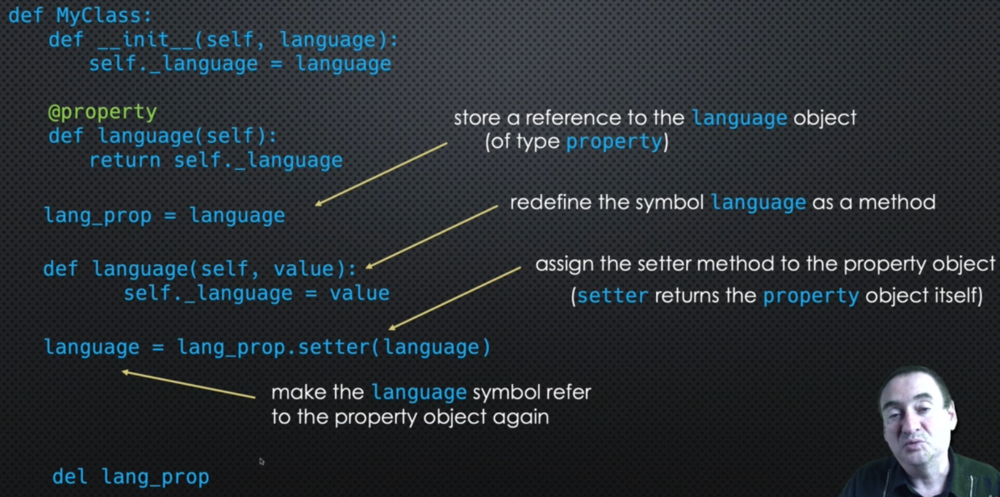

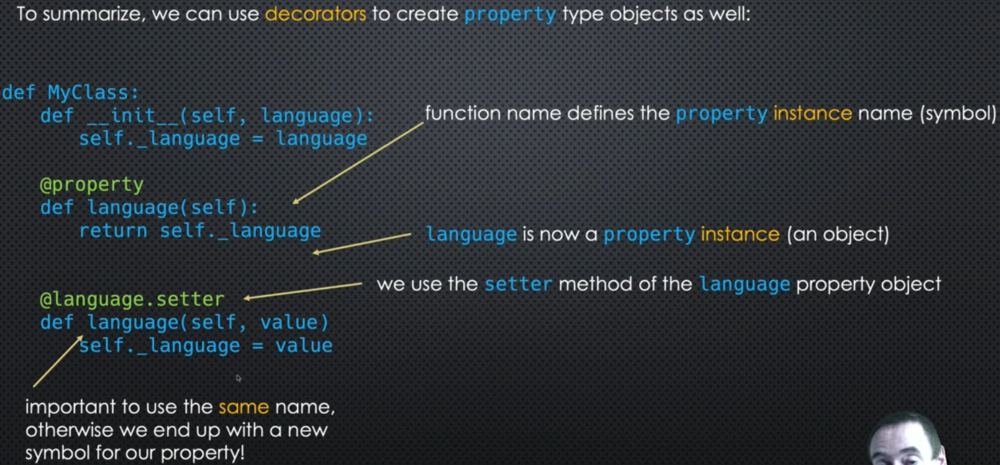

#### When you create a property, it takes a function (e.g. in fget) wrapping it into something else and returns the property

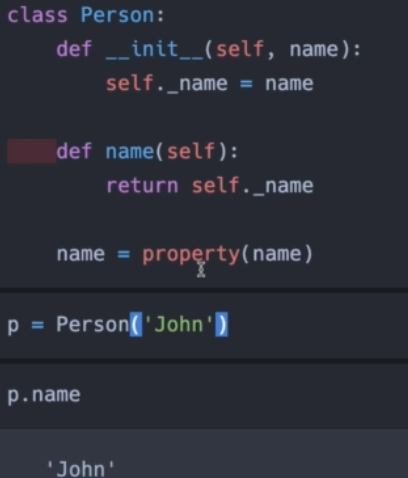

If you want to define the setter on a property that only has the getter defined, then you have to create a new instance of property type and grab the fget from the original instance p and return a new object that has the getter and setter defined!

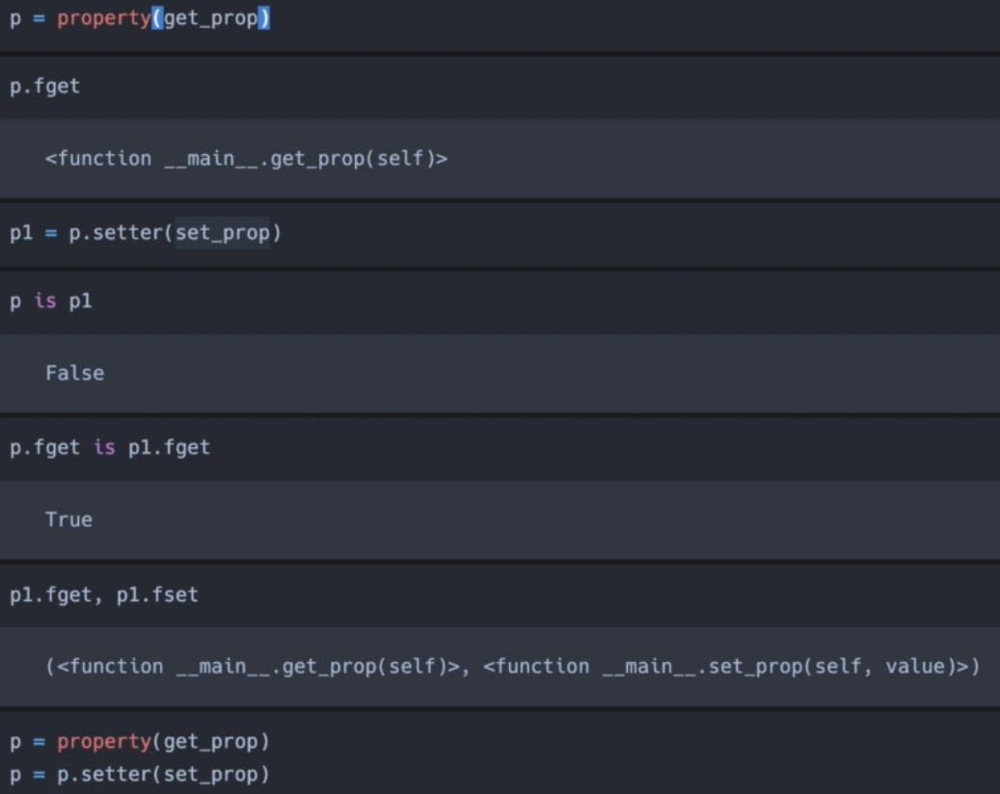

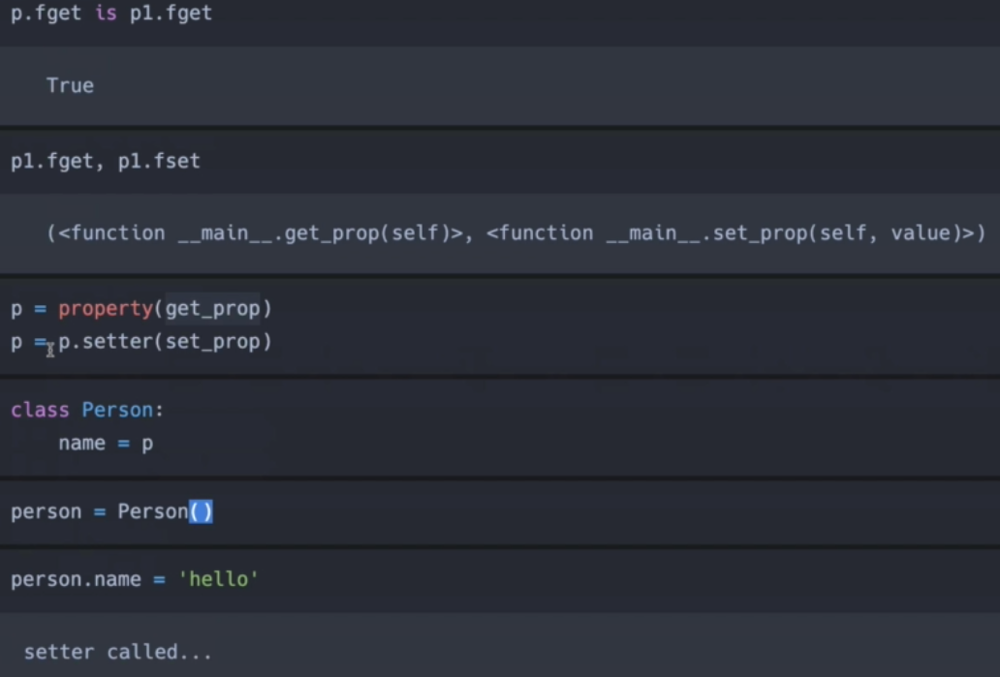

## LEFT AT 19:00

- name.fget references the original function name (def)
- name is a property with a new memory adress

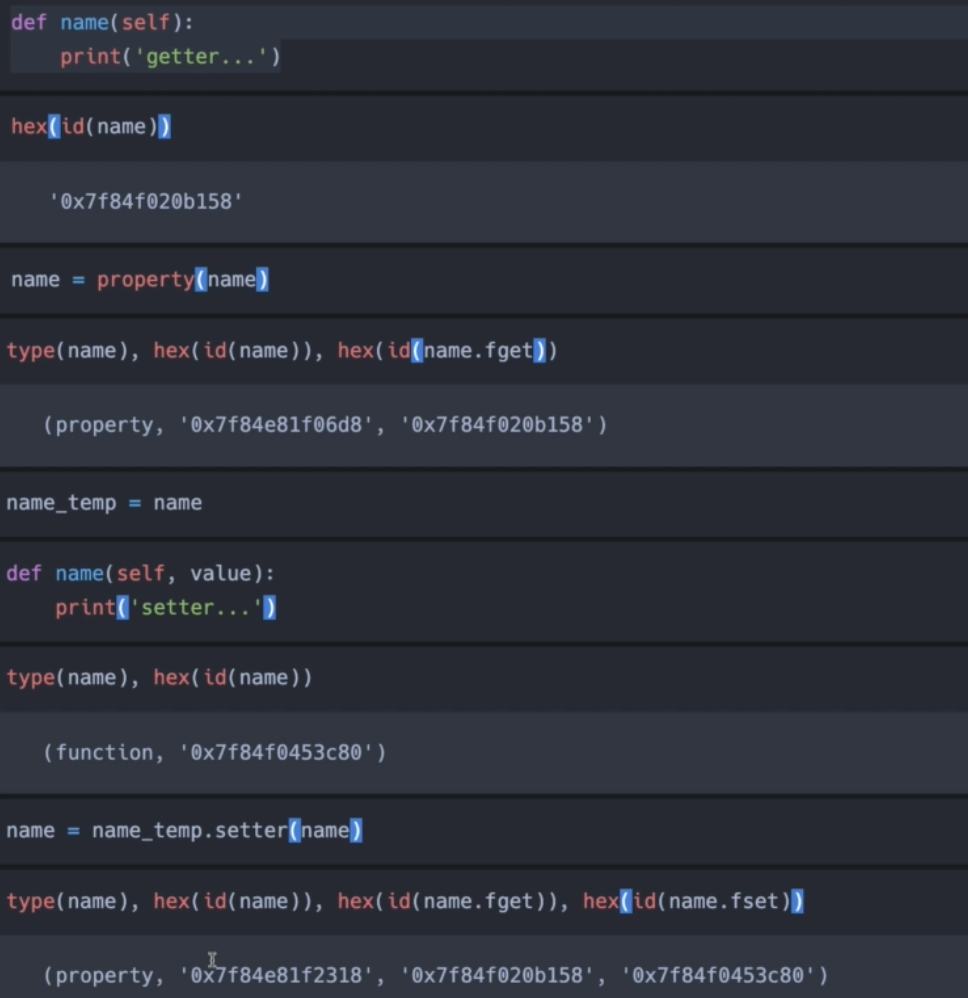

## LEFT AT 23:00

#### 11. Delegating to Parent example

In [52]:
from math import pi
from numbers import Real

class Circle:
    
    def __init__(self,r):
        #self._r = r
        self.radius = r
        
        self._area = None
        self._perimeter = None
        
        print(f'Circle with radius {self._r} area {self._area} and perimeter {self._perimeter} initialized!')
        
    @property    
    def radius(self):
        print('Getter radius')
        return self._r
    
    @radius.setter
    def radius(self, r):
        print('Setter radius')
        if isinstance(r, Real) and r>0:
            self._r = r
            self._area = None
            self._perimeter = None
        else:
            raise ValueError('Radius must be + real Number')
            
    @property
    def area(self):
        print('Getter area')
        if self._area is None:
            #self._area = pi * self._r ** 2
            print('Calculcating area on-the-fly...')
            self._area = pi * self.radius ** 2
        return self._area
    
    @property
    def perimeter(self):
        print('Getter perimeter')
        if self._perimeter is None:
            #self._perimeter = 2 * pi * self._r
            print('Calculcating perimeter on-the-fly...')
            self._perimeter = 2 * pi * self.radius
        return self._perimeter
    

In [53]:
c = Circle(-1)

Setter radius


ValueError: Radius must be + real Number

In [54]:
c = Circle(4)

Setter radius
Circle with radius 4 area None and perimeter None initialized!


In [55]:
c.radius

Getter radius


4

In [56]:
c.area

Getter area
Calculcating area on-the-fly...
Getter radius


50.26548245743669

In [57]:
c.perimeter

Getter perimeter
Calculcating perimeter on-the-fly...
Getter radius


25.132741228718345

## Programiz

- https://www.youtube.com/watch?v=jCzT9XFZ5bw&list=PL-osiE80TeTt2d9bfVyTiXJA-UTHn6WwU&index=45
- https://www.programiz.com/python-programming/property
- https://www.pythoncontent.com/understanding-property-in-python/

In [ ]:
class test:
    def __init__(self):
        self._x=0

    #method to set x value   
    def x_set(self,i):
        print("setting x..")
        self._x=i
        
    #method to read x value
    def x_get(self):
        print("getting x..")
        return self._x

    #method to delete x
    def x_delete(self):
        print("deleting x..")
        del self._x
        
    #set property of x attribute of class T   
    x=property(x_get,x_set,x_delete,"x property ")

T=test()
print("setting T.x value")
T.x=10
print("accessing T.x value")
print(T.x)
print("deleting T.x")
del T.x

In [ ]:
class test:
    def __init__(self):
        self._x=0

    @property
    def x(self):
        return self._x

    #decorator to set x fset
    @x.setter
    def x(self,i):
        print("setting x..")
        self._x=i
        
    #decorator to set x fget
    @x.getter
    def x(self):
        print("getting x..")
        return self._x

    #decorator to set x fdel
    @x.deleter
    def x(self):
        print("deleting x..")
        del self._x


T=test()
print("setting T.x value")
T.x=10
print("accessing T.x value")
print(T.x)
print("deleting T.x")
del T.x

## Accessing class methods as attributes

In [7]:
class Person():
    
    def __init__(self, first, last):
        
        self.first = first
        self.last = last
        self.email = self.first +'.'+self.last+'@gmail.com'
        
    def fullname(self):
        return self.first + ' ' + self.last
    
    @property
    def fullname_asatrr(self):
        return self.first + ' ' + self.last

In [8]:
e1 = Person('Theo', 'Kasio')

In [9]:
e1.email

'Theo.Kasio@gmail.com'

In [10]:
e1.fullname()

'Theo Kasio'

### Notice that it doesn't require parenthensis!!!

In [12]:
e1.fullname_asatrr

'Theo Kasio'

### By setting fullname we would like to change first, last and email

In [22]:
class Person():
    
    def __init__(self, first, last):
        
        self.first = first
        self.last = last
        self.email = self.first +'.'+self.last+'@gmail.com'
    
    @property  
    def fullname(self):
        return self.first + ' ' + self.last

    # setter decorator
    @fullname.setter
    def fullname(self, name):
        self.first, self.last = name.split(' ')

In [23]:
e1 = Person('Theo', 'Kasio')

In [24]:
e1.email

'Theo.Kasio@gmail.com'

In [25]:
e1.fullname

'Theo Kasio'

### Update fullname

In [26]:
e1.fullname = 'Theodoros Kasioumis'

In [28]:
e1.first

'Theodoros'

In [29]:
e1.last

'Kasioumis'

### This is the problem if email is used as an attribute, it doesn't get updated

In [30]:
e1.email

'Theo.Kasio@gmail.com'

## But if we define it as a property then all works
# setter

In [39]:
class Person():
    
    def __init__(self, first, last):
        
        self.first = first
        self.last = last

        
    @property
    def email(self):
        return  self.first +'.'+self.last+'@gmail.com'
    
    @property  
    def fullname(self):
        return self.first + ' ' + self.last

    # setter decorator
    @fullname.setter
    def fullname(self, name):
        self.first, self.last = name.split(' ')
        
    # deleter decorator
    @fullname.deleter
    def fullname(self):
        print('Delete Name!')
        self.first = None
        self.last = None

In [40]:
e1 = Person('Theo', 'Kasio')

In [41]:
e1.email

'Theo.Kasio@gmail.com'

In [42]:
e1.fullname

'Theo Kasio'

### Update fullname

In [43]:
e1.fullname = 'Theodoros Kasioumis'

In [44]:
e1.first

'Theodoros'

In [45]:
e1.last

'Kasioumis'

### Problem solved! :)

In [46]:
e1.email

'Theodoros.Kasioumis@gmail.com'

In [47]:
del e1.fullname

Delete Name!


In [49]:
e1.first